Using matplotlib backend: MacOSX
Populating the interactive namespace from numpy and matplotlib



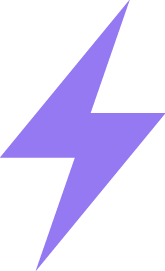

Running local mode, some functionality limited.



In [1]:
%pylab
%matplotlib inline
%config InlineBackend.figure_format = 'retina'
rcParams['figure.figsize'] = (8,4)
import seaborn as sns
from lightning import Lightning
lgn = Lightning(ipython=True, local=True)
lgn.set_size('large')

In [2]:
import pandas as pd
from IPython.html.widgets import *
from scipy.signal import filtfilt, butter
from scipy.signal import resample

:0: FutureWarning: IPython widgets are experimental and may change in the future.


In [3]:
df = pd.read_csv('./data/floor_noise_4.3Mohm_hardware_filter.csv', header=None)
raw_data = df.values[1:,:]

/Users/Chongxi/anaconda/lib/python2.7/site-packages/pandas/io/parsers.py:1170: DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.
  data = self._reader.read(nrows)


In [4]:
raw_data = asarray(raw_data,dtype=float)
raw_data = raw_data*1e6

In [5]:
dt = 2.5e-5
fs = 1/dt
T = len(raw_data)*dt
t = linspace(0,T,len(raw_data))

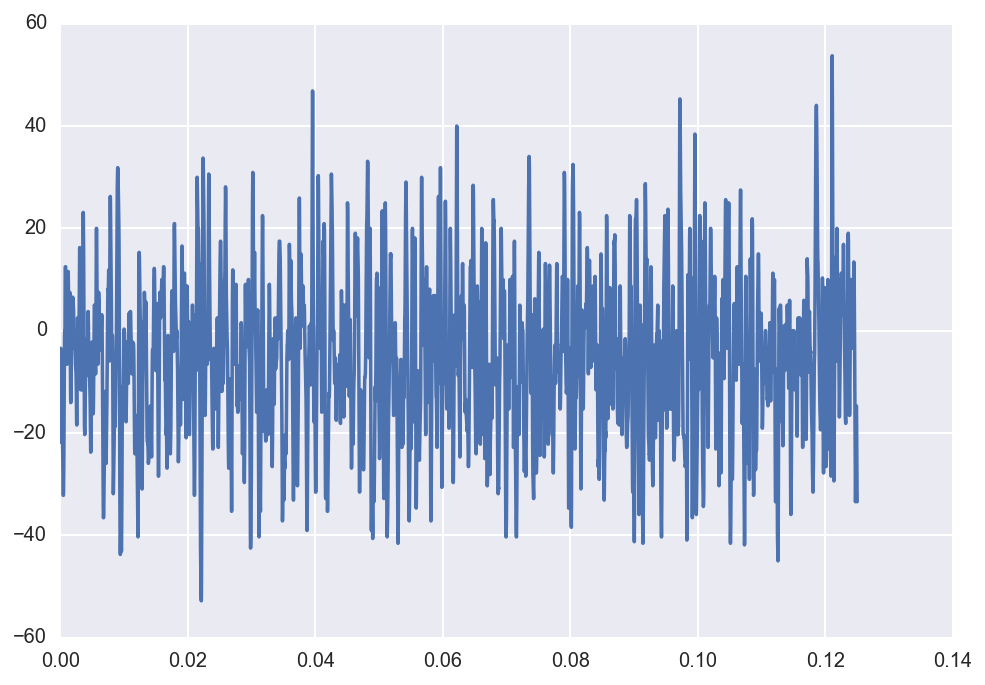

In [6]:
plot(t[:5000],raw_data[:5000,:])

In [7]:
from scipy import signal

In [8]:
sig_ch1 = raw_data[:,0]
f, Pxx_den = signal.welch(sig_ch1, fs, nperseg=256*5, noverlap=128)

In [10]:
# semilogy(f[0:10000],Pxx_den[0:10000])
P1 = log10(Pxx_den)
lgn.line(P1, index=f)

In [37]:
# Create an order 3 bandpass butterworth filter.
def butter_bandpass(lowcut, highcut, fs, order=5):
    nyq = 0.5 * fs
    low = lowcut / nyq
    high = highcut / nyq
    b, a = butter(order, [low, high], btype='band')
    return b, a

def peakdet(v, delta, x = None):
    maxtab = []
    mintab = []
    if x is None:
        x = arange(len(v))
    v = asarray(v)
    mn, mx = Inf, -Inf
    mnpos, mxpos = NaN, NaN
    lookformax = True
    for i in arange(len(v)):
        this = v[i]
        if this > mx:
            mx = this
            mxpos = x[i]
        if this < mn:
            mn = this
            mnpos = x[i]
        if lookformax:
            if this < mx-delta:
                maxtab.append((mxpos, mx))
                mn = this
                mnpos = x[i]
                lookformax = False
        else:
            if this > mn+delta:
                mintab.append((mnpos, mn))
                mx = this
                mxpos = x[i]
                lookformax = True
    return array(maxtab), array(mintab)

In [38]:
b, a = butter_bandpass(300,2000,fs)

In [39]:
# y_d,t_d = resample(raw_data, raw_data.shape[0]/10, t)
y = filtfilt(b, a, raw_data.T, padlen=150, padtype="even")
# y_d,t_d = resample(y,y.shape[1]/2,t)

In [40]:
y_d,t_d = resample(y, y.shape[1]/2, t, axis=1)

In [41]:
y_d.shape

(1, 500000)

In [42]:
lgn.line(y_d, index=t_d, width=900, height=400)

In [85]:
f, Pxx_den = signal.welch(y_d, fs/2, nperseg=256*5, noverlap=128)
P2 = log10(Pxx_den)
lgn.line(P2, index=f)

<h1 style='font-weight: 300'>Spectrum comparison</h1>
<hr>

In [11]:
P = vstack((P1,P2))
lgn.line(P, index=f)

NameError: name 'P2' is not defined

IndexError: index 1 is out of bounds for axis 0 with size 1

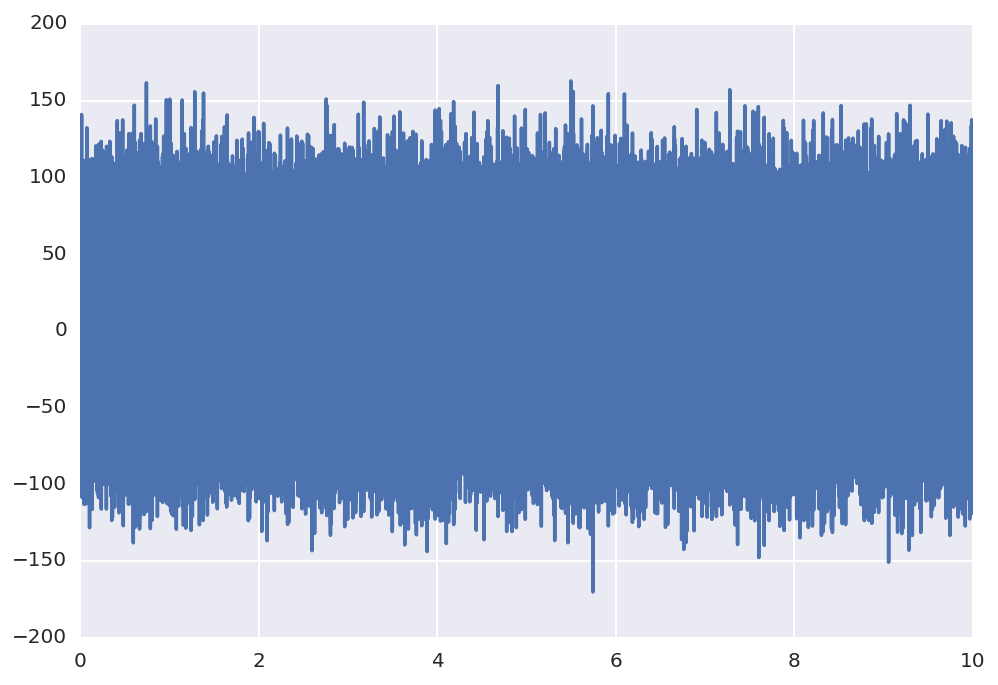

In [14]:
import seaborn as sns
fig = figure()
ax = fig.add_subplot(111)
ax.plot(t,y[0,:],label='ch1')
ax.plot(t,y[1,:],label='ch2')
xlabel('sec')
ylabel('uV')
ax.legend()

In [96]:
fig.savefig('10sec_recording.png', bbox_inches='tight')

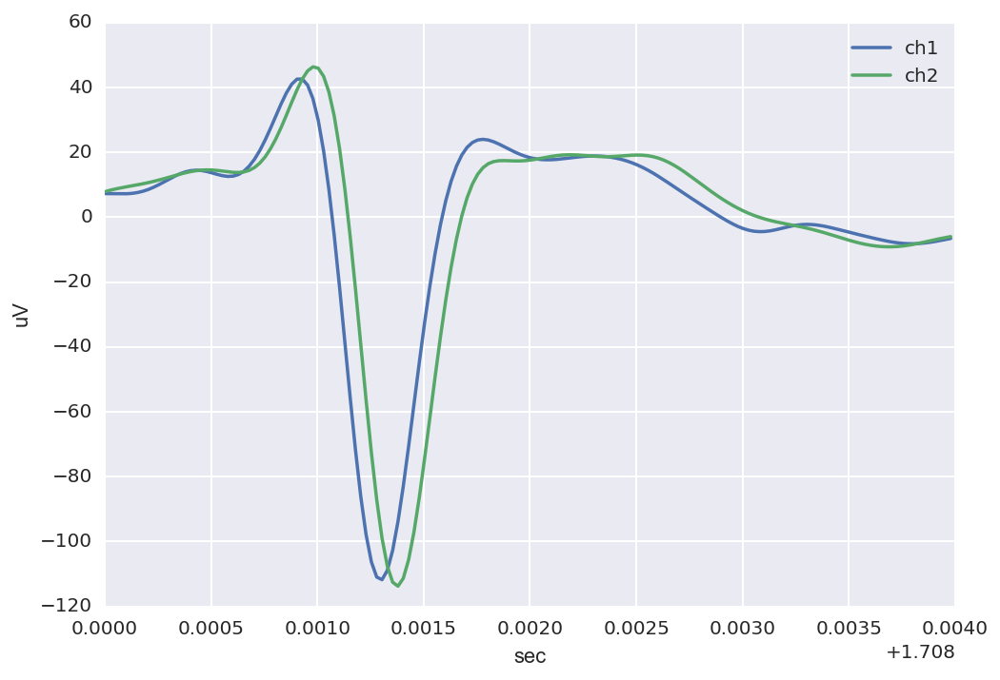

In [115]:
@interact(offset=(t[0],t[-1],dt))
def slide_sig(offset=1.706):
    fig = figure()
    ax = fig.add_subplot(111)
    idx = np.logical_and(t<0.006+offset, t>0.002+offset)
    ax.plot(t[idx],y[0,idx],label='ch1')
    ax.plot(t[idx],y[1,idx],label='ch2')
    xlabel('sec')
    ylabel('uV')
    ax.legend()
    return fig

In [116]:
fig.savefig('spike.png', bbox_inches='tight')

<html lang="en">
<head>
<meta charset="UTF-8">
<title>Example of Bootstrap 3 Button Methods</title>
<link rel="stylesheet" href="https://maxcdn.bootstrapcdn.com/bootstrap/3.3.5/css/bootstrap.min.css">
<link rel="stylesheet" href="https://maxcdn.bootstrapcdn.com/bootstrap/3.3.5/css/bootstrap-theme.min.css">
<script src="https://ajax.googleapis.com/ajax/libs/jquery/1.11.3/jquery.min.js"></script>
<script src="https://maxcdn.bootstrapcdn.com/bootstrap/3.3.5/js/bootstrap.min.js"></script>
<script type="text/javascript">
$(document).ready(function(){
    $("#myButtons .btn").click(function(){
    	$(this).button('toggle');
    });
});
</script>
<style type="text/css">
    .bs-example{
    	margin: 20px;
    }
</style>
</head>
<body>
<div id="myButtons" class="bs-example">
    <button type="button" class="btn btn-default">Default</button>
    <button type="button" class="btn btn-primary">Primary</button>
    <button type="button" class="btn btn-success">Success</button>
    <button type="button" class="btn btn-info">Info</button>
    <button type="button" class="btn btn-warning">Warning</button>
    <button type="button" class="btn btn-danger">Danger</button>
</div>
</body>
</html>                                		

<a href="#" class="btn btn-success btn-lg"><span class="glyphicon glyphicon-edit"></span> Bootstrap Button</a>